<a href="https://colab.research.google.com/github/estherpadrao/esther-capstone/blob/main/Capstone_Midterm.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [76]:
!pip install -q geopandas shapely pyproj h3 libpysal pyogrio pyarrow fastparquet folium


In [77]:
import geopandas as gpd, shapely, pyproj, h3, libpysal, pyogrio, pyarrow, folium
print("✅ Libraries ready!")


✅ Libraries ready!


In [78]:
from google.colab import files
uploaded = files.upload()  # pick your boundary file, e.g., sf_boundary.geojson


Saving sf_polygon.geojson to sf_polygon (1).geojson


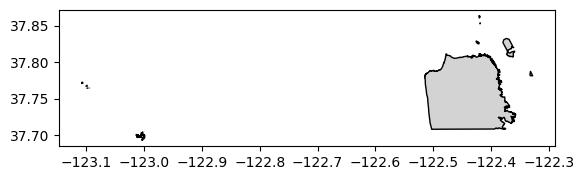

In [79]:
FNAME = "sf_polygon.geojson"
boundary = gpd.read_file(FNAME).explode(index_parts=False, ignore_index=True)
boundary = boundary.to_crs(4326)
boundary.plot(edgecolor="black", facecolor="lightgrey");



In [80]:
import geopandas as gpd, numpy as np
from shapely.geometry import Polygon
from math import sqrt, cos, sin, pi

# boundary: your uploaded SF polygon in EPSG:4326
boundary_m = boundary.to_crs(26910)  # UTM Zone 10N (meters)

# Hex size setting (pointy-top hexes)
hex_diameter_m = 1000       # across flats (change this to taste)
s = hex_diameter_m / 2.0   # hex "radius" (center to flat)
dx = sqrt(3) * s           # horizontal spacing between centers
dy = 1.5 * s               # vertical spacing between centers



In [81]:
xmin, ymin, xmax, ymax = boundary_m.total_bounds
# small buffer so edges are covered
xmin, ymin, xmax, ymax = xmin - dx, ymin - dy, xmax + dx, ymax + dy

xs = np.arange(xmin, xmax + dx, dx)
ys = np.arange(ymin, ymax + dy, dy)



In [82]:
def make_hex(cx, cy, s):
    angles = np.deg2rad(np.arange(0, 360, 60)) + pi/6  # 30° offset
    return Polygon([(cx + s*cos(a), cy + s*sin(a)) for a in angles])

polys = []
for j, y in enumerate(ys):
    xoff = dx/2 if (j % 2) else 0  # stagger every other row
    for x in xs:
        polys.append(make_hex(x + xoff, y, s))

hex_all = gpd.GeoDataFrame(geometry=polys, crs=boundary_m.crs)


In [83]:
# Fast filter: keep hexes whose bbox intersects the boundary bbox
hex_all = hex_all[hex_all.intersects(boundary_m.unary_union if hasattr(boundary_m, "unary_union") else boundary_m.geometry.union_all())]

# Precise clip
hex_clipped = gpd.overlay(hex_all, boundary_m, how="intersection")
hex_clipped["hex_id"] = range(len(hex_clipped))
hex_gdf = hex_clipped.to_crs(4326)  # back to lat/lon for web maps
hex_gdf.head(), len(hex_gdf)


/tmp/ipython-input-465429101.py:2: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  hex_all = hex_all[hex_all.intersects(boundary_m.unary_union if hasattr(boundary_m, "unary_union") else boundary_m.geometry.union_all())]


(   OBJECTID CDTFA_COPRI     CDTFA_CITY          CDTFA_COUNTY  \
 0       371       38001  San Francisco  San Francisco County   
 1       371       38001  San Francisco  San Francisco County   
 2       371       38001  San Francisco  San Francisco County   
 3       371       38001  San Francisco  San Francisco County   
 4       371       38001  San Francisco  San Francisco County   
 
   CENSUS_PLACE_NAME CENSUS_GEOID CENSUS_PLACE_TYPE        GNIS_PLACE_NAME  \
 0     San Francisco      0667000              City  City of San Francisco   
 1     San Francisco      0667000              City  City of San Francisco   
 2     San Francisco      0667000              City  City of San Francisco   
 3     San Francisco      0667000              City  City of San Francisco   
 4     San Francisco      0667000              City  City of San Francisco   
 
    GNIS_ID CDT_CITY_ABBR CDT_COUNTY_ABBR PRIMARY_DOMAIN CENSUS_POPULATION  \
 0  2411786          SFSC             SFC           None    

In [84]:
# make sure both are in WGS84 for Folium
boundary = boundary.to_crs(4326)
hex_gdf  = hex_gdf.to_crs(4326)

# add a simple id if you don't have one
if "hex_id" not in hex_gdf.columns:
    hex_gdf["hex_id"] = hex_gdf.index.astype(int)

# compute hex area (in m²) just for a tooltip
hex_m = hex_gdf.to_crs(26910)
hex_gdf["area_m2"] = hex_m.area.round(0)


In [85]:
import folium

# map centered to your data bounds
minx, miny, maxx, maxy = hex_gdf.total_bounds
m = folium.Map(tiles="cartodbpositron")
m.fit_bounds([[miny, minx], [maxy, maxx]])

# boundary outline (optional)
folium.GeoJson(
    boundary,
    name="Boundary",
    style_function=lambda f: {"color":"black", "weight":1, "fillOpacity":0}
).add_to(m)

# hex layer (light fill, thin borders)
folium.GeoJson(
    hex_gdf,
    name="Hex grid",
    tooltip=folium.features.GeoJsonTooltip(
        fields=["hex_id","area_m2"],
        aliases=["hex_id","area (m²)"],
        sticky=False
    ),
    style_function=lambda f: {"fillColor":"#3388ff", "color":"#3388ff",
                              "weight":0.2, "fillOpacity":0.15}
).add_to(m)

folium.LayerControl().add_to(m)
m


In [86]:
from google.colab import files
uploaded = files.upload()  # pick your Health_Care_Facilities_*.geojson


Saving Health_Care_Facilities_20251030.geojson to Health_Care_Facilities_20251030 (1).geojson


In [87]:
import geopandas as gpd

# if you uploaded:
HEALTH_PATH = list(uploaded.keys())[0]  # or set to the exact filename string

health = gpd.read_file(HEALTH_PATH)
health = health.dropna(subset=["geometry"]).to_crs(4326)  # ensure WGS84
health.head()


,:id,:version,:created_at,:updated_at,uid,oshpd_id,facility_name,facility_type,services,location,:@computed_region_jwn9_ihcz,:@computed_region_6qbp_sg9q,:@computed_region_qgnn_b9vv,:@computed_region_26cr_cadq,:@computed_region_ajp5_b2md,geometry
0,row-wek7~eics.y6w2,rv-h6ee~i6vq~8aer,2021-08-14 00:27:11.549000+00:00,2021-08-14 00:27:14.364000+00:00,3,106380929,California Pacific Med Ctr-pacific Campus,General Acute Care Hospital,Hospital,"{ ""latitude"": 37.79142444, ""longitude"": -122.4...",102,102,4,6,30,POINT (-122.43104 37.79142)
1,row-6muc_unbc~kkde,rv-x245_4j35.w6fh,2021-08-14 00:27:11.549000+00:00,2021-08-14 00:27:14.364000+00:00,39,306384014,On Lok Senior Health Services,Community Clinic,Senior Health,"{ ""latitude"": 37.798467270000003, ""longitude"":...",106,106,6,3,23,POINT (-122.40386 37.79847)
2,row-afm3-gdbc_rbnk,rv-gxka-hxy9.7ndn,2021-08-14 00:27:11.549000+00:00,2021-08-14 00:27:14.364000+00:00,25,306384158,Institute On Aging,Community Clinic,Senior Health,"{ ""latitude"": 37.78246781, ""longitude"": -122.4...",11,11,8,6,31,POINT (-122.44834 37.78247)
3,row-djfx_f9tb.9vzk,rv-nq4k-rb9q_scp7,2021-08-14 00:27:11.549000+00:00,2021-08-14 00:27:14.364000+00:00,20,306381276,"Drug Detoxification, Rehab And After Care Svs....",Free Clinic,Drug Treatment,"{ ""latitude"": 37.770294610000001, ""longitude"":...",25,25,7,11,3,POINT (-122.4487 37.77029)
4,row-5d8x_2qab~h635,rv-fmf5~2sbt~nsrp,2021-08-14 00:27:11.549000+00:00,2021-08-14 00:27:14.364000+00:00,54,306384220,Woman's Community Clinic/tides Center,Community Clinic,Womens Health,"{ ""latitude"": 37.786524399999998, ""longitude"":...",103,103,4,11,30,POINT (-122.43338 37.78652)


In [88]:
import pandas as pd

# Remove or convert problematic columns
for col in health.columns:
    if pd.api.types.is_datetime64_any_dtype(health[col]):
        health[col] = health[col].astype(str)  # convert to string for safety



In [89]:
hex_gdf = hex_gdf.to_crs(4326).copy()
if "hex_id" not in hex_gdf.columns:
    hex_gdf["hex_id"] = hex_gdf.index.astype(int)



In [90]:
# points-in-polygon join
pts_in_hex = gpd.sjoin(
    health,
    hex_gdf[["hex_id","geometry"]],
    how="left",
    predicate="within"
)

# counts per hex_id
hc_counts = pts_in_hex.groupby("hex_id").size().rename("health_cnt")

# attach to hex layer (fill missing with 0)
hex_features = hex_gdf.copy()
hex_features["health_cnt"] = hex_features["hex_id"].map(hc_counts).fillna(0).astype(int)

hex_features[["hex_id","health_cnt"]].head()


,hex_id,health_cnt
0,0,0
1,1,0
2,2,0
3,3,0
4,4,0


In [91]:
# ensure WGS84 for web map; add hex_id if missing
boundary = boundary.to_crs(4326)
hex_gdf  = hex_gdf.to_crs(4326).copy()
if "hex_id" not in hex_gdf.columns:
    hex_gdf["hex_id"] = hex_gdf.index.astype(int)

# clean health GeoDataFrame
health = health.dropna(subset=["geometry"]).to_crs(4326).copy()
for col in health.columns:
    if pd.api.types.is_datetime64_any_dtype(health[col]):
        health[col] = health[col].astype(str)

# map bounds
minx, miny, maxx, maxy = hex_gdf.total_bounds


In [92]:
# work in meters for precise geometry ops
hex_m    = hex_gdf.to_crs(26910)[["hex_id","geometry"]].copy()
health_m = health.to_crs(26910).copy()

# pass 1: points strictly within a hex
p1 = gpd.sjoin(health_m, hex_m, how="left", predicate="within")[["hex_id"]]

# find unassigned (border cases)
unassigned = p1["hex_id"].isna()
health_left = health_m.loc[unassigned].copy()

# pass 2: assign leftovers to nearest hex (unique, deterministic)
if len(health_left):
    p2 = gpd.sjoin_nearest(health_left, hex_m[["hex_id","geometry"]], how="left", max_distance=None, distance_col=None)[["hex_id"]]
    # combine
    p1.loc[unassigned, "hex_id"] = p2["hex_id"].values

# final per-point hex assignment
health_with_hex = health.copy()
health_with_hex["hex_id"] = p1["hex_id"].to_numpy()
health_with_hex["hex_id"] = health_with_hex["hex_id"].astype(int)


In [93]:
# counts per hex
hc_counts = health_with_hex.groupby("hex_id").size().rename("health_cnt")

hex_features = hex_gdf.copy()
hex_features["health_cnt"] = hex_features["hex_id"].map(hc_counts).fillna(0).astype(int)

# simple choropleth + point markers
m = folium.Map(tiles="cartodbpositron")
m.fit_bounds([[miny, minx], [maxy, maxx]])

folium.Choropleth(
    geo_data=hex_features.to_json(),
    data=hex_features,
    columns=["hex_id","health_cnt"],
    key_on="feature.properties.hex_id",
    fill_opacity=0.7, line_opacity=0.2, legend_name="Health centers per hex"
).add_to(m)

# draw boundary outline
folium.GeoJson(boundary, name="Boundary",
               style_function=lambda f: {"color":"black","weight":1,"fillOpacity":0}
              ).add_to(m)

# add health centers as red dots (avoid JSON datetime issues)
for _, r in health.iterrows():
    folium.CircleMarker(
        location=[r.geometry.y, r.geometry.x],
        radius=3, color="red", fill=True, fill_opacity=0.8
    ).add_to(m)

folium.LayerControl().add_to(m)
m


In [94]:
# A) If uploading from your computer:
from google.colab import files
uploaded = files.upload()
PARKS_PATH = list(uploaded.keys())[0]

import geopandas as gpd

parks = gpd.read_file(PARKS_PATH).dropna(subset=["geometry"])
parks = parks.explode(index_parts=False, ignore_index=True)
parks = parks.buffer(0)                    # fix minor geometry issues
parks = gpd.GeoDataFrame(geometry=parks, crs="EPSG:4326")

# Make sure hexes have an id and both are ready
hex_gdf  = hex_gdf.to_crs(4326).copy()
if "hex_id" not in hex_gdf.columns:
    hex_gdf["hex_id"] = hex_gdf.index.astype(int)


Saving Recreation_and_Parks_Properties_20251031.geojson to Recreation_and_Parks_Properties_20251031 (1).geojson


In [95]:
# Project to meters for accurate area
hex_m   = hex_gdf[["hex_id","geometry"]].to_crs(26910)
parks_m = parks.to_crs(26910)

# Fast prefilter (optional, helps speed on big files)
parks_m = parks_m[parks_m.intersects(hex_m.total_bounds.to_crs if False else hex_m.unary_union)]

# Precise intersection
inter = gpd.overlay(hex_m, parks_m, how="intersection")
inter["park_area_m2"] = inter.area

# Sum area per hex
area_by_hex = inter.groupby("hex_id")["park_area_m2"].sum()

# Attach back to WGS84 hexes (fill 0 where no parks)
hex_parks = hex_gdf.copy()
hex_parks["park_area_m2"] = hex_parks["hex_id"].map(area_by_hex).fillna(0)
hex_parks.head()


/tmp/ipython-input-1645071340.py:6: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  parks_m = parks_m[parks_m.intersects(hex_m.total_bounds.to_crs if False else hex_m.unary_union)]


,OBJECTID,CDTFA_COPRI,CDTFA_CITY,CDTFA_COUNTY,CENSUS_PLACE_NAME,CENSUS_GEOID,CENSUS_PLACE_TYPE,GNIS_PLACE_NAME,GNIS_ID,CDT_CITY_ABBR,...,PRIMARY_DOMAIN,CENSUS_POPULATION,CDT_NAME_SHORT,OFFSHORE,AREA_SQMI,GlobalID,geometry,hex_id,area_m2,park_area_m2
0,371,38001,San Francisco,San Francisco County,San Francisco,0667000,City,City of San Francisco,2411786,SFSC,...,None,None,San Francisco,None,47.296328,51eeeb05-519f-4436-833f-8331a8a06a04,"MULTIPOLYGON (((-123.00051 37.69578, -123.0004...",0,30985.0,0.0
1,371,38001,San Francisco,San Francisco County,San Francisco,0667000,City,City of San Francisco,2411786,SFSC,...,None,None,San Francisco,None,47.296328,51eeeb05-519f-4436-833f-8331a8a06a04,"POLYGON ((-123.00274 37.69416, -123.00273 37.6...",1,5905.0,0.0
2,371,38001,San Francisco,San Francisco County,San Francisco,0667000,City,City of San Francisco,2411786,SFSC,...,None,None,San Francisco,None,47.296328,51eeeb05-519f-4436-833f-8331a8a06a04,"POLYGON ((-123.00493 37.70232, -123.00493 37.7...",2,368.0,0.0
3,371,38001,San Francisco,San Francisco County,San Francisco,0667000,City,City of San Francisco,2411786,SFSC,...,None,None,San Francisco,None,47.296328,51eeeb05-519f-4436-833f-8331a8a06a04,"MULTIPOLYGON (((-123.00609 37.69728, -123.0061...",3,54331.0,0.0
4,371,38001,San Francisco,San Francisco County,San Francisco,0667000,City,City of San Francisco,2411786,SFSC,...,None,None,San Francisco,None,47.296328,51eeeb05-519f-4436-833f-8331a8a06a04,"POLYGON ((-123.01305 37.70075, -123.013 37.700...",4,96490.0,0.0


In [96]:
import folium

minx, miny, maxx, maxy = hex_parks.total_bounds
m = folium.Map(tiles="cartodbpositron")
m.fit_bounds([[miny, minx], [maxy, maxx]])

folium.Choropleth(
    geo_data=hex_parks.to_json(),
    data=hex_parks,
    columns=["hex_id","park_area_m2"],
    key_on="feature.properties.hex_id",
    fill_opacity=0.7, line_opacity=0.2,
    legend_name="Park area per hex (m²)"
).add_to(m)

folium.LayerControl().add_to(m)
m


In [97]:
from google.colab import files
import pandas as pd, geopandas as gpd
from shapely.geometry import Point

uploaded = files.upload()
csv_name = list(uploaded.keys())[0]
df = pd.read_csv(csv_name)



Saving Schools_20251031.csv to Schools_20251031 (1).csv


In [98]:
import re
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point

# df: your schools DataFrame already read from CSV
# Example: df = pd.read_csv("schools.csv")

def parse_loc1(s):
    if pd.isna(s):
        return None
    # find the first "(lat, lon)" pair anywhere in the string
    m = re.search(r"\(\s*([+-]?\d+(?:\.\d+)?)\s*,\s*([+-]?\d+(?:\.\d+)?)\s*\)", str(s))
    if not m:
        return None
    lat, lon = float(m.group(1)), float(m.group(2))
    return Point(lon, lat)  # shapely expects (x=lon, y=lat)

df["geometry"] = df["Location 1"].apply(parse_loc1)
schools = gpd.GeoDataFrame(df.dropna(subset=["geometry"]), geometry="geometry", crs="EPSG:4326")
len(schools), schools.geometry.iloc[0]



(445, <POINT (-122.42 37.784)>)

In [99]:

# ensure hex grid is ready
hex_gdf = hex_gdf.to_crs(4326).copy()
if "hex_id" not in hex_gdf.columns:
    hex_gdf["hex_id"] = hex_gdf.index.astype(int)

# do geometry in meters for robustness
hex_m     = hex_gdf[["hex_id","geometry"]].to_crs(26910)
schools_m = schools.to_crs(26910).copy()

# pass 1: strictly inside
p1 = gpd.sjoin(schools_m, hex_m, how="left", predicate="within")[["hex_id"]]

# pass 2: leftovers (on borders, etc.) → nearest hex
left = p1["hex_id"].isna()
if left.any():
    p2 = gpd.sjoin_nearest(schools_m.loc[left], hex_m, how="left")[["hex_id"]]
    p1.loc[left, "hex_id"] = p2["hex_id"].values

schools_with_hex = schools.copy()
schools_with_hex["hex_id"] = p1["hex_id"].astype(int)

print("Total schools:", len(schools_with_hex))
print("Hexes with ≥1 school:", schools_with_hex['hex_id'].nunique())



Total schools: 445
Hexes with ≥1 school: 151


In [100]:
school_counts = schools_with_hex.groupby("hex_id").size().rename("school_cnt")


hex_features = hex_gdf.copy()
hex_features["school_cnt"] = hex_features["hex_id"].map(school_counts).fillna(0).astype(int)


minx, miny, maxx, maxy = hex_gdf.total_bounds
m = folium.Map(tiles="cartodbpositron")
m.fit_bounds([[miny, minx], [maxy, maxx]])

folium.Choropleth(
    geo_data=hex_features.to_json(),
    data=hex_features,
    columns=["hex_id","school_cnt"],
    key_on="feature.properties.hex_id",
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name="Schools per hex"    # ← same legend style
).add_to(m)

folium.GeoJson(
    boundary,
    name="Boundary",
    style_function=lambda f: {"color":"black","weight":1,"fillOpacity":0}
).add_to(m)

for _, r in schools_with_hex.iterrows():
    folium.CircleMarker(
        location=[r.geometry.y, r.geometry.x],
        radius=3,
        color="#800080",       # purple, consistent across your project
        fill=True,
        fill_opacity=0.8,
        popup=str(r.get("Campus Name", "School"))
    ).add_to(m)

folium.LayerControl().add_to(m)
m





In [101]:
from google.colab import files
uploaded = files.upload()                     # pick your MUNI routes file (e.g., Muni_Simple_Routes.geojson)
ROUTES_PATH = list(uploaded.keys())[0]
ROUTES_PATH


Saving Muni_Simple_Routes_20251031.geojson to Muni_Simple_Routes_20251031 (1).geojson


'Muni_Simple_Routes_20251031 (1).geojson'

In [102]:
import geopandas as gpd
from shapely.geometry import LineString, MultiLineString

# Read your uploaded file
routes = gpd.read_file(ROUTES_PATH).dropna(subset=["geometry"])
routes = routes.to_crs(26910)
hex_m = hex_gdf[["hex_id","geometry"]].to_crs(26910)

print(routes.geom_type.value_counts())
print(hex_m.geom_type.value_counts())




MultiLineString    131
Name: count, dtype: int64
Polygon         260
MultiPolygon     14
Name: count, dtype: int64


In [103]:
from shapely.strtree import STRtree
import numpy as np

sindex = routes.sindex
lengths = {}

for idx, hx in zip(hex_m["hex_id"], hex_m.geometry):
    # find candidate lines that intersect this hex
    cand_idx = list(sindex.intersection(hx.bounds))
    if not cand_idx:
        lengths[idx] = 0.0
        continue

    # get candidate geometries and compute intersection
    candidates = routes.iloc[cand_idx].geometry
    clipped = [g.intersection(hx) for g in candidates]

    # sum up the total line length
    total = 0.0
    for geom in clipped:
        if geom.is_empty:
            continue
        if isinstance(geom, LineString):
            total += geom.length
        elif isinstance(geom, MultiLineString):
            total += sum(seg.length for seg in geom.geoms)
    lengths[idx] = total

print("Finished computing lengths for", len(lengths), "hexes")


Finished computing lengths for 274 hexes


In [104]:
hex_routes = hex_gdf.to_crs(4326).copy()
hex_routes["muni_length_m"] = hex_routes["hex_id"].map(lengths).fillna(0.0)

hex_routes["muni_length_m"].describe()




,muni_length_m
count,274.000000
mean,5234.594113
std,6342.919325
min,0.000000
25%,0.000000
50%,3670.681735
75%,8671.451369
max,54002.601289


In [105]:
import folium
import numpy as np

hex_routes["hex_id_str"] = hex_routes["hex_id"].astype(str)
nz = hex_routes.loc[hex_routes["muni_length_m"] > 0, "muni_length_m"]
bins = [0] + list(nz.quantile([0.2, 0.4, 0.6, 0.8, 1.0])) if len(nz) >= 5 else [0, 1, 2, 3, 4]

minx, miny, maxx, maxy = hex_routes.total_bounds
m = folium.Map(tiles="cartodbpositron")
m.fit_bounds([[miny, minx], [maxy, maxx]])

folium.Choropleth(
    geo_data=hex_routes.to_json(),
    data=hex_routes,
    columns=["hex_id_str", "muni_length_m"],
    key_on="feature.properties.hex_id_str",
    bins=bins,         # ✅ same palette as health & schools
    fill_opacity=0.7,
    line_opacity=0.2,
    nan_fill_color="#f0f0f0",
    legend_name="MUNI route length per hex (m)"
).add_to(m)

folium.GeoJson(
    routes.to_crs(4326)[["geometry"]],
    name="MUNI routes",
    style_function=lambda f: {"color": "#d62728", "weight": 1, "opacity": 0.8}
).add_to(m)

# 5️⃣ Optional: boundary outline for consistency
folium.GeoJson(
    boundary,
    name="Boundary",
    style_function=lambda f: {"color": "black", "weight": 1, "fillOpacity": 0}
).add_to(m)

folium.LayerControl().add_to(m)
m



In [106]:
# If you just uploaded in Colab:
from google.colab import files
uploaded = files.upload()  # pick MTA_Bike_Network_Linear_Features_20251031.geojson
BIKE_PATH = list(uploaded.keys())[0]

# If your hex grid isn't in memory yet, load it now:
# import geopandas as gpd
# hex_gdf = gpd.read_file("hex_grid.geojson").to_crs(4326)
# If you already have hex_gdf, just ensure WGS84 and an id:
hex_gdf = hex_gdf.to_crs(4326).copy()
if "hex_id" not in hex_gdf.columns:
    hex_gdf["hex_id"] = hex_gdf.index.astype(int)



Saving MTA_Bike_Network_Linear_Features_20251031.geojson to MTA_Bike_Network_Linear_Features_20251031 (1).geojson


In [107]:
import geopandas as gpd
import pandas as pd

bike_raw = gpd.read_file(BIKE_PATH).dropna(subset=["geometry"])
print("CRS:", bike_raw.crs)
print("Geometry types:", bike_raw.geom_type.value_counts())
print("Columns:", list(bike_raw.columns)[:15])
bike_raw.head(2)


CRS: EPSG:4326
Geometry types: LineString    5438
Name: count, dtype: int64
Columns: [':id', ':version', ':created_at', ':updated_at', 'objectid', 'cnn', 'streetname', 'from_st', 'to_st', 'facility_t', 'direct', 'surface_tr', 'barrier', 'notes', 'dir']


,:id,:version,:created_at,:updated_at,objectid,cnn,streetname,from_st,to_st,facility_t,...,buffered,raised,contraflow,greenwave,biap,sm_sweeper,recommendation,data_as_of,data_loaded_at,geometry
0,row-6kvm~i9sq.du2k,rv-d3nx_krqz-n7ik,2025-06-17 20:45:19.106000+00:00,2025-06-17 20:45:19.106000+00:00,3149,8018000,LAKE ST,10TH AV,11TH AV,CLASS II,...,NO,NO,NO,NO,NO,NO,1,2023-05-19 13:12:05,2025-06-17 13:45:07.467,"LINESTRING (-122.46897 37.78648, -122.47004 37..."
1,row-hqv7~f53r_2htb,rv-bpha-mc5y-8nn2,2025-06-17 20:45:19.106000+00:00,2025-06-17 20:45:19.106000+00:00,4163,6282000,GOLDEN GATE AVE,ANNAPOLIS TER,TAMALPAIS TER,CLASS II,...,NO,NO,NO,NO,NO,NO,1,2023-05-19 13:12:06,2025-06-17 13:45:07.467,"LINESTRING (-122.4478 37.77755, -122.44868 37...."


In [108]:
import geopandas as gpd
from shapely.geometry import LineString, MultiLineString, Point
import pandas as pd

bike_m = bike_raw.to_crs(26910).copy()
hex_m  = hex_gdf[["hex_id","geometry"]].to_crs(26910).copy()

def line_midpoint(geom):
    if geom.is_empty:
        return None
    if isinstance(geom, LineString):
        return geom.interpolate(0.5, normalized=True)
    elif isinstance(geom, MultiLineString):
        parts = [g.interpolate(0.5, normalized=True) for g in geom.geoms if not g.is_empty]
        if not parts:
            return None
        # take average of all midpoints
        xs, ys = zip(*[(p.x, p.y) for p in parts])
        return Point(sum(xs)/len(xs), sum(ys)/len(ys))
    else:
        return None

bike_m["length_m"] = bike_m.length
bike_m["midpoint"] = bike_m.geometry.apply(line_midpoint)

# drop empties
bike_m = bike_m.dropna(subset=["midpoint", "length_m"])
midpoints = gpd.GeoDataFrame(bike_m[["length_m"]], geometry=bike_m["midpoint"], crs=26910)

print("midpoints:", len(midpoints), "avg length:", midpoints["length_m"].mean())


midpoints: 5438 avg length: 139.57886267345762


In [109]:
joined = gpd.sjoin(midpoints, hex_m, how="inner", predicate="within")
len(joined), joined.head()


(5438,
      length_m                        geometry  index_right  hex_id
 0   94.268857  POINT (546710.572 4182255.228)          212     212
 1   78.607567  POINT (548589.004 4181270.814)          199     199
 2  150.832803  POINT (548786.221 4181303.963)          199     199
 3  207.372209  POINT (546965.916 4181959.615)          213     213
 4   95.519643  POINT (544912.972 4182092.616)          210     210)

In [110]:
lengths = joined.groupby("hex_id")["length_m"].sum().to_dict()
print("nonzero hexes:", len(lengths), "of", len(hex_m))


nonzero hexes: 192 of 274


In [111]:
hex_bike = hex_gdf.to_crs(4326).copy()
hex_bike["bike_length_m"] = hex_bike["hex_id"].map(lengths).fillna(0.0)

print(hex_bike["bike_length_m"].describe())

import folium, numpy as np

hex_bike["hex_id_str"] = hex_bike["hex_id"].astype(str)
nz = hex_bike.loc[hex_bike["bike_length_m"]>0, "bike_length_m"]
bins = [0] + list(nz.quantile([0.2,0.4,0.6,0.8,1.0])) if len(nz)>=5 else [0,1,2,3,4]

minx, miny, maxx, maxy = hex_bike.total_bounds
m = folium.Map(tiles="cartodbpositron")
m.fit_bounds([[miny,minx],[maxy,maxx]])

folium.Choropleth(
    geo_data=hex_bike.to_json(),
    data=hex_bike[["hex_id_str","bike_length_m"]],
    columns=["hex_id_str","bike_length_m"],
    key_on="feature.properties.hex_id_str",
    bins=bins,
    fill_opacity=0.7, line_opacity=0.2,
    nan_fill_color="#f0f0f0",
    legend_name="Bike network length per hex (m)"
).add_to(m)

folium.GeoJson(
    bike_raw.to_crs(4326)[["geometry"]],
    name="Bike network",
    style_function=lambda f: {"color":"#000000","weight":1,"opacity":0.8}
).add_to(m)

folium.LayerControl().add_to(m)
m


count      274.000000
mean      2770.181953
std       2603.202067
min          0.000000
25%          0.000000
50%       2316.209481
75%       4449.368615
max      12012.377685
Name: bike_length_m, dtype: float64


In [112]:
from google.colab import files
uploaded = files.upload()   # pick Muni_Stops_20251031.geojson
STOPS_PATH = list(uploaded.keys())[0]
STOPS_PATH


Saving Muni_Stops_20251031.geojson to Muni_Stops_20251031 (1).geojson


'Muni_Stops_20251031 (1).geojson'

In [113]:
import geopandas as gpd
import pandas as pd

stops = gpd.read_file(STOPS_PATH).dropna(subset=["geometry"])
stops = stops.to_crs(4326).copy()

# Folium-safe: convert datetime columns to strings
for c in stops.columns:
    if pd.api.types.is_datetime64_any_dtype(stops[c]):
        stops[c] = stops[c].astype(str)

stops.head(), stops.geom_type.unique(), stops.crs


(                  :id           :version                       :created_at  \
 0  row-t8d7-bwx6-nimz  rv-i3k3.gm9m.hthb  2025-09-02 16:26:38.777000+00:00   
 1  row-xtda~8aqr.abgu  rv-r8ie-86wf_vbed  2025-09-02 16:26:38.777000+00:00   
 2  row-2764.fucc-89pv  rv-udqj~3mht-6eeu  2025-09-02 16:26:38.777000+00:00   
 3  row-zb94.2vs7.tdx4  rv-fu74~2p7n-3jpd  2025-09-02 16:26:38.777000+00:00   
 4  row-5dgy.8pj2~6esx  rv-q8rv-qp4g_rtsi  2025-09-02 16:26:38.777000+00:00   
 
                         :updated_at objectid                         stopname  \
 0  2025-09-02 16:26:44.949000+00:00   100712       Ulloa & Claremont NW-FS/PS   
 1  2025-09-02 16:26:44.949000+00:00   100841        Jones St&Turk ST SW-FS/PS   
 2  2025-09-02 16:26:44.949000+00:00   100466         3rd St&Paul Ave SW-FS/SB   
 3  2025-09-02 16:26:44.949000+00:00   100169       Fulton St&6TH Ave NW-FS/BZ   
 4  2025-09-02 16:26:44.949000+00:00    99249  Fillmore St&Lombard St SW-FS/BZ   
 
   trapezestopabbr rucusstopab

In [114]:
hex_gdf = hex_gdf.to_crs(4326).copy()
if "hex_id" not in hex_gdf.columns:
    hex_gdf["hex_id"] = hex_gdf.index.astype(int)


In [115]:
# do geometry in meters for robust spatial ops
hex_m   = hex_gdf[["hex_id","geometry"]].to_crs(26910)
stops_m = stops.to_crs(26910).copy()

# Pass 1: strictly within
pts_in = gpd.sjoin(stops_m, hex_m, how="left", predicate="within")[["hex_id"]]

# Pass 2: any unassigned (border cases) → nearest hex
left = pts_in["hex_id"].isna()
if left.any():
    nearest = gpd.sjoin_nearest(stops_m.loc[left], hex_m, how="left")[["hex_id"]]
    pts_in.loc[left, "hex_id"] = nearest["hex_id"].values

stops_with_hex = stops.copy()
stops_with_hex["hex_id"] = pts_in["hex_id"].astype(int)

print("Total stops:", len(stops_with_hex))
print("Hexes w/ ≥1 stop:", stops_with_hex["hex_id"].nunique())


Total stops: 3264
Hexes w/ ≥1 stop: 193


In [116]:
# simple count per hex
stop_counts = stops_with_hex.groupby("hex_id").size().rename("muni_stops_cnt")

hex_stops = hex_gdf.copy()
hex_stops["muni_stops_cnt"] = hex_stops["hex_id"].map(stop_counts).fillna(0).astype(int)
hex_stops[["hex_id","muni_stops_cnt"]].head()


,hex_id,muni_stops_cnt
0,0,0
1,1,0
2,2,0
3,3,0
4,4,0


In [117]:
# 1) count stops per hex
stop_counts = stops_with_hex.groupby("hex_id").size().rename("muni_stops_cnt")

# 2) attach counts to hexes
hex_stops = hex_gdf.copy()
hex_stops["muni_stops_cnt"] = hex_stops["hex_id"].map(stop_counts).fillna(0).astype(int)
hex_stops["hex_id_str"] = hex_stops["hex_id"].astype(str)

# 3) bins + palette (match your schools/health maps)
nz = hex_stops.loc[hex_stops["muni_stops_cnt"] > 0, "muni_stops_cnt"]
bins = [0,1,2,3,5,10] if len(nz) < 5 else [0] + list(nz.quantile([0.2,0.4,0.6,0.8,1.0]))

# 4) map
minx, miny, maxx, maxy = hex_stops.total_bounds
m = folium.Map(tiles="cartodbpositron")
m.fit_bounds([[miny, minx], [maxy, maxx]])

# choropleth by stop count
folium.Choropleth(
    geo_data=hex_stops.to_json(),
    data=hex_stops[["hex_id_str","muni_stops_cnt"]],
    columns=["hex_id_str","muni_stops_cnt"],
    key_on="feature.properties.hex_id_str",
    bins=bins,
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name="MUNI stops per hex"
) .add_to(m)

# thin hex outlines
folium.GeoJson(
    hex_gdf,
    name="Hex grid",
    style_function=lambda f: {"color":"#3388ff", "weight":0.3, "fillOpacity":0}
).add_to(m)

# stop dots (orange)
for _, r in stops_with_hex.iterrows():
    folium.CircleMarker(
        location=[r.geometry.y, r.geometry.x],
        radius=2.5,
        color="#FFA500",
        fill=True,
        fill_opacity=0.8,
        popup=str(r.get("stop_name", r.get("name", "MUNI stop")))
    ).add_to(m)

folium.LayerControl().add_to(m)
m



In [118]:
from google.colab import files
uploaded = files.upload()   # pick Bicycle_Parking_Racks_20251031.geojson
BIKE_RACKS_PATH = list(uploaded.keys())[0]
BIKE_RACKS_PATH


Saving Bicycle_Parking_Racks_20251031.geojson to Bicycle_Parking_Racks_20251031 (1).geojson


'Bicycle_Parking_Racks_20251031 (1).geojson'

In [119]:
import geopandas as gpd
import pandas as pd

racks = gpd.read_file(BIKE_RACKS_PATH).dropna(subset=["geometry"]).to_crs(4326).copy()

# convert datetime columns to strings to avoid Folium JSON errors
for c in racks.columns:
    if pd.api.types.is_datetime64_any_dtype(racks[c]):
        racks[c] = racks[c].astype(str)

racks.head(), racks.geom_type.unique(), racks.crs


(                  :id           :version                       :created_at  \
 0  row-c53s~hr9v~7q5e  rv-s43q.driw_vdqy  2024-06-17 17:17:22.886000+00:00   
 1  row-e3ag-zmip.42ai  rv-5f7e.kb2d-y74v  2024-06-17 17:17:22.886000+00:00   
 2  row-8e7u~p4ny.zbg2  rv-fu5x.ukz3.bmij  2024-06-17 17:17:22.886000+00:00   
 3  row-xj4e_i2z2-px4m  rv-7t6b~v49q-6z9s  2024-06-17 17:17:22.886000+00:00   
 4  row-jn4e.ew7h~j4px  rv-4tdx~9ctc_5t7q  2024-06-17 17:17:22.886000+00:00   
 
                         :updated_at objectid              address  \
 0  2024-06-17 17:17:28.451000+00:00    12183        Belden Street   
 1  2024-06-17 17:17:28.451000+00:00    20813  1984 Mission Street   
 2  2024-06-17 17:17:28.451000+00:00    11638       2762 FOLSOM ST   
 3  2024-06-17 17:17:28.451000+00:00    12367       51 HAVELOCK ST   
 4  2024-06-17 17:17:28.451000+00:00    11235       3300 BALBOA ST   
 
                     location          street placement racks  ...  \
 0               Belden Place   

In [120]:
hex_gdf = hex_gdf.to_crs(4326).copy()
if "hex_id" not in hex_gdf.columns:
    hex_gdf["hex_id"] = hex_gdf.index.astype(int)


In [121]:
# work in meters for robust spatial ops
hex_m   = hex_gdf[["hex_id","geometry"]].to_crs(26910)
racks_m = racks.to_crs(26910).copy()

# Pass 1: strictly within
import geopandas as gpd
p1 = gpd.sjoin(racks_m, hex_m, how="left", predicate="within")[["hex_id"]]

# Pass 2: any unassigned (on borders, tiny gaps) → nearest hex
left = p1["hex_id"].isna()
if left.any():
    p2 = gpd.sjoin_nearest(racks_m.loc[left], hex_m, how="left")[["hex_id"]]
    p1.loc[left, "hex_id"] = p2["hex_id"].values

racks_with_hex = racks.copy()
racks_with_hex["hex_id"] = p1["hex_id"].astype(int)

print("Total racks:", len(racks_with_hex))
print("Hexes with ≥1 rack:", racks_with_hex["hex_id"].nunique())


Total racks: 5967
Hexes with ≥1 rack: 165


In [122]:
rack_counts = racks_with_hex.groupby("hex_id").size().rename("bike_racks_cnt")

hex_racks = hex_gdf.copy()
hex_racks["bike_racks_cnt"] = hex_racks["hex_id"].map(rack_counts).fillna(0).astype(int)
hex_racks[["hex_id","bike_racks_cnt"]].head()


,hex_id,bike_racks_cnt
0,0,0
1,1,0
2,2,0
3,3,0
4,4,0


In [123]:
# 1) count racks per hex
rack_counts = racks_with_hex.groupby("hex_id").size().rename("bike_racks_cnt")

# 2) attach to hex grid
hex_racks_map = hex_gdf.copy()
hex_racks_map["bike_racks_cnt"] = hex_racks_map["hex_id"].map(rack_counts).fillna(0).astype(int)
hex_racks_map["hex_id_str"] = hex_racks_map["hex_id"].astype(str)

# 3) bins + palette (match health/schools/stops)
nz = hex_racks_map.loc[hex_racks_map["bike_racks_cnt"] > 0, "bike_racks_cnt"]
bins = [0,1,2,3,5,10] if len(nz) < 5 else [0] + list(nz.quantile([0.2,0.4,0.6,0.8,1.0]))

# 4) map
minx, miny, maxx, maxy = hex_racks_map.total_bounds
m = folium.Map(tiles="cartodbpositron")
m.fit_bounds([[miny, minx], [maxy, maxx]])

# choropleth by rack count
folium.Choropleth(
    geo_data=hex_racks_map.to_json(),
    data=hex_racks_map[["hex_id_str","bike_racks_cnt"]],
    columns=["hex_id_str","bike_racks_cnt"],
    key_on="feature.properties.hex_id_str",
    bins=bins,
    fill_opacity=0.7,
    line_opacity=0.2,
    nan_fill_color="#f0f0f0",
    legend_name="Bike racks per hex"
).add_to(m)

# hex outlines (thin)
folium.GeoJson(
    hex_gdf,
    name="Hex grid",
    style_function=lambda f: {"color":"#3388ff", "weight":0.3, "fillOpacity":0}
).add_to(m)

# rack dots (green)
for _, r in racks_with_hex.iterrows():
    folium.CircleMarker(
        location=[r.geometry.y, r.geometry.x],
        radius=2.5,
        color="#2ca02c",
        fill=True,
        fill_opacity=0.85,
        popup=str(r.get("rack_id", r.get("location", "Bike rack")))
    ).add_to(m)

folium.LayerControl().add_to(m)
m



In [124]:
import pandas as pd
from google.colab import files

# 1️⃣ Upload the CSV
uploaded = files.upload()
filename = list(uploaded.keys())[0]
permits = pd.read_csv(filename)

# 2️⃣ Normalize column names
permits.columns = (
    permits.columns
    .str.strip()           # remove leading/trailing spaces
    .str.lower()           # make lowercase
    .str.replace(r'\s+', '_', regex=True)  # replace spaces with underscores
)

print("Cleaned column names:", permits.columns.tolist())

# 3️⃣ Detect likely column for permit type
possible_cols = [c for c in permits.columns if "type" in c]
print("\nPossible columns containing 'type':", possible_cols)

# 4️⃣ Pick the right one automatically (should catch 'permit_type')
if "permit_type" in permits.columns:
    colname = "permit_type"
else:
    colname = possible_cols[0] if possible_cols else None

# 5️⃣ Show unique categories and their counts
if colname:
    print(f"\nUnique values in '{colname}' column:\n")
    print(permits[colname].dropna().str.strip().value_counts())
else:
    print("\nNo column containing 'type' found — check above column names.")




Saving Active_Street-Use_Permits_20251031.csv to Active_Street-Use_Permits_20251031 (1).csv
Cleaned column names: ['permit_number', 'streetname', 'cross_street_1', 'cross_street_2', 'permit_type', 'agent', 'agentphone', 'permit_purpose', 'approved_date', 'status', 'cnn', 'permit_zipcode', 'permit_start_date', 'permit_end_date', 'permit_address', '24/7_contact', 'inspector', 'curbrampwork', 'x', 'y', 'latitude', 'longitude', 'bpa', 'location', 'the_geom', 'analysis_neighborhood', 'supervisor_district', 'data_as_of', 'data_loaded_at']

Possible columns containing 'type': ['permit_type']

Unique values in 'permit_type' column:

permit_type
Excavation     4789
Wireless       1255
StrtImprov      508
TempOccup       498
MinorEnc        207
Referral        189
FoodFac         157
Parklet          84
conformity       69
ExcStreet        47
SpecSide         44
Sidewalk         38
NightNoise       37
Boring           36
minorenc         22
Vault            21
StreetSpace      20
StorCont       

In [125]:
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point
import numpy as np
import folium

# --- 0) Clean columns and pick lat/lon from your CSV ---
permits = permits.copy()
permits.columns = (
    permits.columns
    .str.strip().str.lower()
    .str.replace(r"\s+", "_", regex=True)
)

# Expect 'latitude' & 'longitude' columns (from your note)
assert "latitude" in permits.columns and "longitude" in permits.columns, "Need 'Latitude' and 'Longitude' columns."

# Coerce to numeric; drop bad coords
permits["latitude"]  = pd.to_numeric(permits["latitude"], errors="coerce")
permits["longitude"] = pd.to_numeric(permits["longitude"], errors="coerce")
permits = permits.dropna(subset=["latitude","longitude"]).copy()

# Filter to your selected types (adjust name if needed)
type_col = "permit_type" if "permit_type" in permits.columns else "type"
TARGET_TYPES = ["TempOccup","FoodFac","Parklet","Sidewalk","TableChair"]
permits = permits[permits[type_col].astype(str).str.strip().isin(TARGET_TYPES)].copy()

# Build point geometry in WGS84
permits_gdf = gpd.GeoDataFrame(
    permits,
    geometry=[Point(xy) for xy in zip(permits["longitude"], permits["latitude"])],
    crs=4326
)

# --- 1) Assign each point to exactly one hex (within → nearest) ---
hex_wgs = hex_gdf.to_crs(4326).copy()
hex_m   = hex_wgs[["hex_id","geometry"]].to_crs(26910)
pts_m   = permits_gdf.to_crs(26910)

# Pass 1: within
p1 = gpd.sjoin(pts_m, hex_m, how="left", predicate="within")[["hex_id"]]

# Pass 2: nearest for the NaNs (allow a generous search radius)
left = p1["hex_id"].isna()
if left.any():
    p2 = gpd.sjoin_nearest(pts_m.loc[left], hex_m, how="left", max_distance=5000)  # 5 km safety radius
    p1.loc[left, "hex_id"] = p2["hex_id"].values

# Any still NaN are outside city/invalid → drop & report
unassigned = p1["hex_id"].isna().sum()
if unassigned:
    print(f"Warning: {unassigned} permit points are outside the study area and will be dropped.")
p1 = p1.dropna(subset=["hex_id"]).copy()

# Attach hex_id (use pandas nullable Int64 to be extra safe, then cast to int)
permits_with_hex = permits_gdf.loc[p1.index].to_crs(4326).copy()
permits_with_hex["hex_id"] = p1["hex_id"].astype("Int64")
permits_with_hex = permits_with_hex.dropna(subset=["hex_id"]).copy()
permits_with_hex["hex_id"] = permits_with_hex["hex_id"].astype(int)

# --- 2) Count per hex (total & by type) ---
permits_with_hex["_type_norm"] = permits_with_hex[type_col].astype(str).str.strip()

total_counts = permits_with_hex.groupby("hex_id").size().rename("permit_cnt")
by_type = (permits_with_hex.groupby(["hex_id","_type_norm"])
           .size().unstack(fill_value=0).reset_index())

# Merge counts for mapping
hex_map = hex_wgs.copy()
hex_map["permit_cnt"] = hex_map["hex_id"].map(total_counts).fillna(0).astype(int)
hex_map["hex_id_str"] = hex_map["hex_id"].astype(str)

# --- 3) Map choropleth + dots ---
PALETTE = "YlOrRd"
nz = hex_map.loc[hex_map["permit_cnt"]>0, "permit_cnt"]
bins = [0,1,2,3,5,10] if len(nz)<5 else [0] + list(nz.quantile([0.2,0.4,0.6,0.8,1.0]) )

minx, miny, maxx, maxy = hex_map.total_bounds
m = folium.Map(tiles="cartodbpositron"); m.fit_bounds([[miny, minx],[maxy, maxx]])

folium.Choropleth(
    geo_data=hex_map.to_json(),
    data=hex_map[["hex_id_str","permit_cnt"]],
    columns=["hex_id_str","permit_cnt"],
    key_on="feature.properties.hex_id_str",
    bins=bins,
    fill_opacity=0.7,
    line_opacity=0.2,
    nan_fill_color="#f0f0f0",
    legend_name="Selected street-use permits per hex"
).add_to(m)

# dots colored by type (consistent palette)
TYPE_COLOR = {
    "TempOccup":"#964B00", "FoodFac":"#FFC0CB", "Parklet":"#808080",
    "Sidewalk":"#008080", "TableChair":"#90EE90"
}
for _, r in permits_with_hex.iterrows():
    folium.CircleMarker(
        location=[r.geometry.y, r.geometry.x],
        radius=2.8,
        color=TYPE_COLOR.get(r["_type_norm"], "#444444"),
        fill=True, fill_opacity=0.9,
        popup=f"{r['_type_norm']}"
    ).add_to(m)

folium.LayerControl().add_to(m)
m



In [131]:
# --- Upload CA block-group shapefile (zip OR separate files), then compute hex income & map ---
!pip -q install censusdata

import io, zipfile, os
import numpy as np
import pandas as pd
import geopandas as gpd
import folium
import censusdata
from google.colab import files

# ========== 1) Upload ==========
print("▶️ Upload your CA block-group shapefile:")
uploaded = files.upload()  # pick either a single .zip or the .shp/.shx/.dbf/.prj component files

# write uploaded files to /content
for name, data in uploaded.items():
    with open(name, "wb") as f:
        f.write(data)

# Detect BG path (zip or loose files)
BG_PATH = None
zip_names = [n for n in uploaded.keys() if n.lower().endswith(".zip")]
if zip_names:
    zip_path = os.path.join("/content", zip_names[0])
    # find .shp inside zip
    with zipfile.ZipFile(zip_path) as zf:
        shp_inside = [n for n in zf.namelist() if n.lower().endswith(".shp")]
        if not shp_inside:
            raise ValueError("No .shp found inside the uploaded ZIP.")
        BG_PATH = f"zip://{zip_path}!{shp_inside[0]}"
else:
    # user uploaded loose files; find the .shp filename
    shp_names = [n for n in uploaded.keys() if n.lower().endswith(".shp")]
    if not shp_names:
        raise ValueError("No .shp file uploaded. Upload a .zip or the full .shp/.shx/.dbf/.prj set.")
    BG_PATH = os.path.join("/content", shp_names[0])

print("✅ Detected BG path:", BG_PATH)






▶️ Upload your CA block-group shapefile:


Saving tl_2024_06_bg.zip to tl_2024_06_bg (3).zip
✅ Detected BG path: zip:///content/tl_2024_06_bg (3).zip!tl_2024_06_bg.shp


In [132]:
# Install Java 21 and set JAVA_HOME for this session
!sudo apt-get update -y
!sudo apt-get install -y openjdk-21-jre-headless

# Make JAVA_HOME visible to Python processes launched by the notebook
!echo 'export JAVA_HOME=/usr/lib/jvm/java-21-openjdk-amd64' >> ~/.bashrc
!echo 'export PATH=$JAVA_HOME/bin:$PATH' >> ~/.bashrc
%env JAVA_HOME=/usr/lib/jvm/java-21-openjdk-amd64
%env PATH=$JAVA_HOME/bin:$PATH

# (Optional) verify
!java -version

,hex_id,hex_mean_income
228,228,508359.218889
248,248,436736.869821
206,206,417634.729316
227,227,414973.262905
238,238,396336.246148
256,256,389782.932166
247,247,389782.932166
237,237,389782.932166
221,221,386153.144077
82,82,360721.473349


In [172]:
# =========================
# PCI (Hansen) – SIMPLE OSMnx NETWORK (walk + bike)
# =========================
import math, warnings
import numpy as np, pandas as pd, geopandas as gpd
from shapely.geometry import Point
from IPython.display import display
warnings.filterwarnings("ignore", category=UserWarning)

# --- deps ---
try:
    import osmnx as ox
except Exception:
    %pip -q install osmnx==1.9.4
    import osmnx as ox
import networkx as nx

# ---------- PARAMS ----------
SPEEDS = {"walk": 4.8, "bike": 15.0}            # km/h (constant per mode)
BETAS  = {"parks": 0.05, "health": 0.10, "schools": 0.06}
WEIGHTS= {"parks": 0.20, "health": 0.50, "schools": 0.30}

US_MEDIAN_INCOME = 83_730.0
GAMMA_INCOME     = 0.50
DAMP_CLIP        = (0.85, 1.20)

LAMBDA_EFF = 0.40
CRS_WGS, CRS_METRIC = 4326, 26910
TOL_PARK, TOL_LAND  = 0.98, 0.05
CUTOFF_MIN = 60.0

# ---------- INPUTS REQUIRED ----------
assert 'hex_gdf' in globals(), "Need hex_gdf (EPSG:4326) polygons."
for nm in ("parks","health","schools"):
    assert nm in globals() and len(globals()[nm])>0, f"Missing {nm} layer."

def to4326(gdf):
    return gdf.to_crs(CRS_WGS) if (gdf.crs and gdf.crs.to_epsg()!=CRS_WGS) else gdf

def ensure_hex_id(df):
    return df if "hex_id" in df.columns else df.reset_index(drop=False).rename(columns={"index":"hex_id"})

# ---------- 1) ORIGINS & ATTR ----------
hex_all = ensure_hex_id(to4326(hex_gdf)).copy()
if "pop" not in hex_all: hex_all["pop"] = 1.0

def pick_income_col(df):
    cands = [c for c in df.columns if "income" in c.lower()]
    if not cands: return None
    cands = sorted(cands, key=lambda c: ("median" not in c.lower(), "mean" not in c.lower(), c))
    return cands[0]

income_col = pick_income_col(hex_all)
if not income_col:
    for alt in ["hex_median_income","median_income","hex_mean_income","mean_inc"]:
        if alt in hex_all: income_col = alt; break

if income_col:
    raw = (hex_all[income_col].astype(str)
           .str.replace(r"[\$, ]","", regex=True).str.replace("\u00a0",""))
    inc = pd.to_numeric(raw, errors="coerce").clip(5_000, 500_000).fillna(US_MEDIAN_INCOME).to_numpy(float)
else:
    inc = np.full(len(hex_all), US_MEDIAN_INCOME, float)

damp_vec = np.clip((inc/US_MEDIAN_INCOME)**GAMMA_INCOME, *DAMP_CLIP)
hex_cent = hex_all.to_crs(CRS_METRIC).centroid.to_crs(CRS_WGS)

# ---------- 2) OSMnx NETWORKS (walk + bike) ----------
if 'boundary' in globals() and len(boundary)>0:
    aoi_poly = to4326(boundary).unary_union
else:
    aoi_poly = to4326(hex_all).unary_union

ox.settings.use_cache = True
ox.settings.log_console = False

def osm_graph(polygon, mode, spd_kmh):
    G = ox.graph_from_polygon(polygon, network_type=mode, simplify=True, retain_all=False)
    if not all('length' in d for _,_,d in G.edges(data=True)):
        G = ox.add_edge_lengths(G)
    for _,_,d in G.edges(data=True):
        Lm = d.get("length", 0.0)
        d["time_min"] = max((Lm/1000.0)/spd_kmh*60.0, 0.001)
    return G

G_walk = osm_graph(aoi_poly, "walk", SPEEDS["walk"])
G_bike = osm_graph(aoi_poly, "bike", SPEEDS["bike"])

def nearest_nodes(G, gdf_pts):
    return ox.nearest_nodes(G, gdf_pts.geometry.x.to_numpy(), gdf_pts.geometry.y.to_numpy())

orig_nodes_walk = nearest_nodes(G_walk, gpd.GeoDataFrame(geometry=hex_cent, crs=CRS_WGS))
orig_nodes_bike = nearest_nodes(G_bike, gpd.GeoDataFrame(geometry=hex_cent, crs=CRS_WGS))

# ---------- 3) DESTINATIONS & MASSES ----------
parks_w   = to4326(parks).copy()
health_w  = to4326(health).copy()
schools_w = to4326(schools).copy()
hex_idx   = hex_all[["hex_id","geometry"]]

# parks as centroids; mass = area (ha)
parks_pts = gpd.GeoDataFrame(geometry=parks_w.to_crs(CRS_METRIC).centroid.to_crs(CRS_WGS), crs=CRS_WGS)
parks_pts["M"] = (parks_w.to_crs(CRS_METRIC).area/10_000.0).clip(lower=0.1).to_numpy()
parks_pts = gpd.sjoin(parks_pts, hex_idx, how="left", predicate="within").rename(columns={"hex_id":"dest_hex"})

def mass_by_pop(points):
    if len(points)==0:
        return points.assign(dest_hex=pd.Series(dtype=hex_all["hex_id"].dtype), M=0.0)
    jj = gpd.sjoin(points, hex_idx, how="left", predicate="within")
    M = jj["hex_id"].map(hex_all.set_index("hex_id")["pop"]).fillna(1.0).astype(float).to_numpy()
    out = points.copy()
    out["dest_hex"] = jj["hex_id"].values
    out["M"] = M
    return out

health_w  = mass_by_pop(health_w)
schools_w = mass_by_pop(schools_w)

# snap amenities
parks_nodes_walk   = nearest_nodes(G_walk, parks_pts)    if len(parks_pts)>0 else np.array([])
health_nodes_walk  = nearest_nodes(G_walk, health_w)     if len(health_w)>0  else np.array([])
schools_nodes_walk = nearest_nodes(G_walk, schools_w)    if len(schools_w)>0 else np.array([])

parks_nodes_bike   = nearest_nodes(G_bike, parks_pts)    if len(parks_pts)>0 else np.array([])
health_nodes_bike  = nearest_nodes(G_bike, health_w)     if len(health_w)>0  else np.array([])
schools_nodes_bike = nearest_nodes(G_bike, schools_w)    if len(schools_w)>0 else np.array([])

# ---------- 4) HANSEN OVER NETWORK (best of walk/bike) ----------
def hansen(G, orig_nodes, dest_nodes, dest_mass, beta, damp_vec, cutoff_min=CUTOFF_MIN):
    A = np.zeros(len(orig_nodes), float)
    # aggregate mass per node
    m_by_node = {}
    for n, m in zip(dest_nodes, dest_mass):
        if not np.isnan(m) and m>0:
            m_by_node[n] = m_by_node.get(n, 0.0) + float(m)

    for i, on in enumerate(orig_nodes):
        tdict = nx.single_source_dijkstra_path_length(G, on, weight="time_min",
                                                      cutoff=cutoff_min if cutoff_min else None)
        if not tdict:
            continue
        damp = float(damp_vec[i])
        s = 0.0
        for dn, Mj in m_by_node.items():
            tij = tdict.get(dn)
            if tij is None:
                continue
            s += Mj * math.exp(-beta * (tij * damp))
        A[i] = s
    return A

def amenity_access_best():
    res = {}
    def layer(pts, nodes_w, nodes_b, beta):
        if len(pts)==0: return np.zeros(len(hex_all))
        M = pts["M"].to_numpy()
        Aw = hansen(G_walk, orig_nodes_walk, nodes_w, M, beta, damp_vec, CUTOFF_MIN)
        Ab = hansen(G_bike,  orig_nodes_bike, nodes_b, M, beta, damp_vec, CUTOFF_MIN)
        return np.maximum(Aw, Ab)

    res["parks"]   = layer(parks_pts,   parks_nodes_walk,   parks_nodes_bike,   BETAS["parks"])
    res["health"]  = layer(health_w,    health_nodes_walk,  health_nodes_bike,  BETAS["health"])
    res["schools"] = layer(schools_w,   schools_nodes_walk, schools_nodes_bike, BETAS["schools"])
    return res

A = amenity_access_best()

# ---------- 5) NORMALIZE & WEIGHT & BONUS ----------
def norm01_100(x):
    x = np.asarray(x, float)
    if x.size==0: return x
    mn, mx = np.nanmin(x), np.nanmax(x)
    return np.zeros_like(x) if (not np.isfinite(mn) or not np.isfinite(mx) or mx<=mn) else 100*(x-mn)/(mx-mn)

for k in A: hex_all[f"{k}_n"] = norm01_100(A[k])

W = {k: WEIGHTS[k] for k in WEIGHTS if f"{k}_n" in hex_all}
W = {k: v/sum(W.values()) for k,v in W.items()}

hex_all["PCI_raw"] = sum(W[k]*hex_all[f"{k}_n"] for k in W)

perm_counts = pd.Series(dtype=int)
if 'permits_with_hex' in globals() and len(permits_with_hex)>0:
    jj = gpd.sjoin(permits_with_hex.to_crs(CRS_WGS)[["geometry"]],
                   hex_all[["hex_id","geometry"]], how="left", predicate="within")
    perm_counts = jj["hex_id"].value_counts(dropna=True)
hex_all["permits"] = hex_all["hex_id"].map(perm_counts).fillna(0).astype(int)
rank = hex_all["permits"].rank(pct=True).fillna(0.0)
hex_all["Eff"] = 1.0 + LAMBDA_EFF*rank
hex_all["PCI"] = hex_all["PCI_raw"] * hex_all["Eff"]

# ---------- 6) MASK WATER & PARK-ONLY ----------
hex_m = hex_all[["hex_id","geometry","PCI","pop"]].to_crs(CRS_METRIC).copy()
hex_m["hex_area"] = hex_m.geometry.area

water_edge = pd.Series(False, index=hex_m.index)
if 'boundary' in globals() and len(boundary)>0:
    bnd_u = boundary.to_crs(CRS_METRIC).unary_union.buffer(0)
    land_area = hex_m.geometry.intersection(bnd_u).area
    hex_m["land_cov"] = np.divide(land_area, hex_m["hex_area"], out=np.zeros_like(land_area), where=hex_m["hex_area"]>0)
    water_edge = hex_m["land_cov"].fillna(0) < TOL_LAND

park_only = pd.Series(False, index=hex_m.index)
if len(parks_w)>0:
    p_u = parks_w.to_crs(CRS_METRIC).unary_union.buffer(0)
    p_area = hex_m.geometry.intersection(p_u).area
    park_cov = np.divide(p_area, hex_m["hex_area"], out=np.zeros_like(p_area), where=hex_m["hex_area"]>0)
    park_only = (hex_m["pop"].fillna(0)<=0) & (pd.Series(park_cov, index=hex_m.index).fillna(0) >= TOL_PARK)

hex_all["PCI_final"] = hex_all["PCI"].astype(float)
to_nan_ids = set(hex_m.loc[water_edge | park_only, "hex_id"].astype(hex_all["hex_id"].dtype))
hex_all.loc[hex_all["hex_id"].isin(to_nan_ids), "PCI_final"] = np.nan
hex_all["PCI_display"] = hex_all["PCI_final"].fillna(0.0)

# ---------- 7) OUTPUT ----------
print(f"Income-damp range: {damp_vec.min():.3f}–{damp_vec.max():.3f} (mean {damp_vec.mean():.3f})")
print(f"PCI_raw mean={hex_all['PCI_raw'].mean():.2f} | Eff mean={hex_all['Eff'].mean():.2f} | PCI mean={hex_all['PCI'].mean():.2f}")
print(f"Citywide PCI (mean, excl. park-only/water): {hex_all['PCI_final'].mean(skipna=True):.2f}")

cols_base = ["hex_id","PCI","PCI_raw","Eff","permits","PCI_final"]
cols_attr = [c for c in ["pop", income_col, "parks_n","health_n","schools_n"] if c in hex_all.columns]
pci_table = hex_all[cols_base + cols_attr].sort_values("PCI_final", ascending=False).reset_index(drop=True)
display(pci_table.head(25))


Income-damp range: 0.850–1.200 (mean 1.017)
PCI_raw mean=36.75 | Eff mean=1.20 | PCI mean=45.18
Citywide PCI (mean, excl. park-only/water): 45.18


,hex_id,PCI,PCI_raw,Eff,permits,PCI_final,pop,hex_median_income,parks_n,health_n,schools_n
0,202,125.259439,93.061513,1.345985,7,125.259439,10314.141369,-1.589317e+08,65.307567,100.000000,100.000000
1,203,120.543337,87.424231,1.378832,14,120.543337,14230.791659,-1.039572e+08,59.232573,94.638410,94.195036
2,218,120.268033,88.632171,1.356934,8,120.268033,26110.891613,-1.686942e+08,56.475983,97.264222,95.682876
3,217,119.711572,88.222084,1.356934,8,119.711572,11157.381024,-9.179493e+07,62.264797,92.583072,98.258628
4,188,116.599906,86.627913,1.345985,7,116.599906,7145.259778,-1.829570e+08,65.186556,89.997551,95.306087
5,187,115.067420,88.166871,1.305109,3,115.067420,10535.607344,-4.670101e+07,72.563443,87.751870,99.260823
6,170,113.119915,82.652951,1.368613,11,113.119915,10116.185275,-1.772110e+08,70.313270,81.031178,93.582360
7,219,112.299290,80.591947,1.393431,23,112.299290,3677.092523,-3.304320e+08,53.597995,85.794320,89.917293
8,169,110.028328,82.687224,1.330657,5,110.028328,8033.780513,-5.675692e+07,78.338547,76.456294,95.971226
9,201,109.211352,83.679839,1.305109,3,109.211352,9585.269456,-6.984802e+07,66.330435,83.314024,95.855800


In [173]:
# ---------- 8) QUICK FOLIUM MAP (same look & feel) ----------
# =========================
# PCI (walk + bike + transit) – Folium visualization
# =========================
import folium

# set map extent
minx, miny, maxx, maxy = hex_all.total_bounds
m = folium.Map(tiles="cartodbpositron", zoom_start=13)
m.fit_bounds([[miny, minx], [maxy, maxx]])

# --- Choropleth of PCI ---
folium.Choropleth(
    geo_data=hex_all.to_json(),
    data=hex_all,
    columns=["hex_id", "PCI_display"],
    key_on="feature.properties.hex_id",
    fill_color="YlOrRd",
    fill_opacity=0.8,
    line_opacity=0.15,
    legend_name="People Connectivity Index (Hansen: walk + bike + transit)"
).add_to(m)

# --- Park polygons (green context) ---
folium.GeoJson(
    to4326(parks)[["geometry"]],
    name="Parks",
    style_function=lambda f: {
        "color": "#228B22",
        "weight": 0.4,
        "fillColor": "#9ACD32",
        "fillOpacity": 0.55
    }
).add_to(m)

# --- Optional layers: health, schools ---
fg_health  = folium.FeatureGroup(name="Health Services", show=False)
fg_schools = folium.FeatureGroup(name="Schools", show=False)

for _, r in to4326(health).iterrows():
    folium.CircleMarker(
        [r.geometry.y, r.geometry.x],
        radius=3, color="#e41a1c",
        fill=True, fill_opacity=0.85,
        popup="Health facility"
    ).add_to(fg_health)

for _, r in to4326(schools).iterrows():
    folium.CircleMarker(
        [r.geometry.y, r.geometry.x],
        radius=3, color="#377eb8",
        fill=True, fill_opacity=0.85,
        popup="School"
    ).add_to(fg_schools)

fg_health.add_to(m)
fg_schools.add_to(m)

# --- Optional: show transit stops (if GTFS loaded) ---
if HAS_TRANSIT:
    try:
        from r5py import TransportNetwork
        if "tn" in globals():
            # tn.transit_stops_gdf() returns GeoDataFrame of GTFS stops (r5py)
            stops_gdf = tn.transit_stops_gdf()
            fg_transit = folium.FeatureGroup(name="Transit stops", show=False)
            for _, r in stops_gdf.iterrows():
                folium.CircleMarker(
                    [r.geometry.y, r.geometry.x],
                    radius=2, color="#8B008B", fill=True, fill_opacity=0.7,
                    popup=str(r.get("stop_name", "Transit stop"))
                ).add_to(fg_transit)
            fg_transit.add_to(m)
    except Exception as e:
        print("⚠️ Transit stops could not be displayed:", e)

# --- Layer control ---
folium.LayerControl(collapsed=False).add_to(m)

m
